In [28]:
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

In [29]:
""" 
    camera_intrinsic_matrix = [
                                [f_x, 0, u_0],
                                [0, f_y, v_0],
                                [0, 0, 1]
                                ]
"""

def disparity_to_point(disparity, camera_intrinsic_matrix, baseline):
    f_x = camera_intrinsic_matrix[0, 0]
    f_y = camera_intrinsic_matrix[1, 1]
    u_0 = camera_intrinsic_matrix[0, 2]
    v_0 = camera_intrinsic_matrix[1, 2]
    
    n_rows, n_columns = disparity.shape
    points = []

    mean_disparity = np.mean(disparity)
    std_disparity = np.std(disparity)

    for v in range(n_rows):
        for u in range(n_columns):
            d = disparity[v, u]
            if d > (mean_disparity - 0.5 * std_disparity):
                z = (f_x * baseline) / d
                x = (u - u_0) * z / f_x
                y = (v - v_0) * z / f_y
                points.append([x, y, z])
                
    return np.array(points)

In [30]:
# RGB image frame
RGB_IMAGE_PATH = "Assignment/rgb_frame.png"
RGB_IMAGE = plt.imread(RGB_IMAGE_PATH)

# Disparity image
DISPARITY_IMAGE_PATH = "Assignment/Disparity.png"
DISPARITY_IMAGE = plt.imread(DISPARITY_IMAGE_PATH)

# camera intrinsic matrix
CAMERA_INTRINSIC = np.array([
                    [398.7956237792969, 0.0,          315.4751892089844],
                    [0.0,        398.7956237792969,   205.1688232421875],
                    [0.0,               0.0,                          1]
                    ])

# distance between the sterio camera centers
BASELINE = 0.075 #m


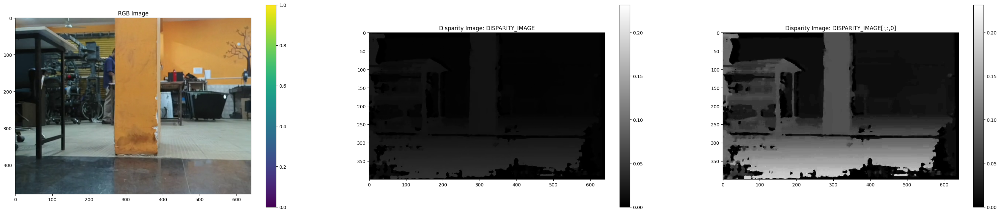

In [31]:
# Debug plot of disparity image
plt.figure(figsize=(640/16.3, 400/50))

plt.subplot(1,3,1)
plt.imshow(RGB_IMAGE)
plt.title("RGB Image")
plt.colorbar()


plt.subplot(1,3,2)
plt.imshow(DISPARITY_IMAGE, cmap='gray')
plt.title("Disparity Image: DISPARITY_IMAGE")
plt.colorbar()


plt.subplot(1,3,3)
plt.imshow(DISPARITY_IMAGE[:,:,0], cmap='gray')
plt.title("Disparity Image: DISPARITY_IMAGE[:,:,0]")
plt.colorbar()
plt.show()

In [53]:
# Since each channel of disparity (400,640,3) is same. So using first channel 
point_cloud = disparity_to_point(DISPARITY_IMAGE[:,:,0], CAMERA_INTRINSIC, BASELINE)
point_cloud_scaled = point_cloud/np.max(point_cloud, axis=0) # scaled between 0 and 1

In [54]:
point_cloud.shape

(123992, 3)

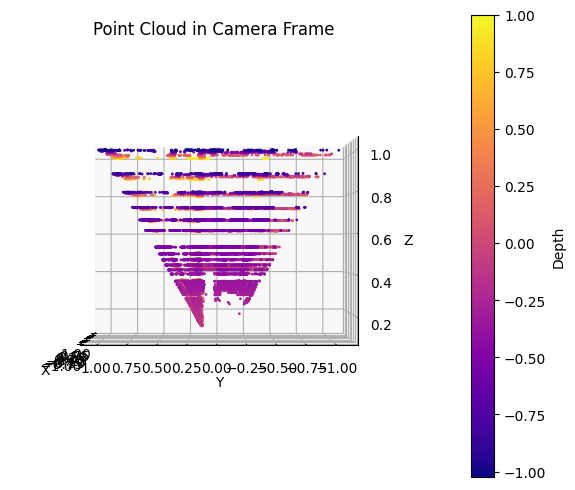

In [55]:
fig = plt.figure(figsize=(7, 6))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(point_cloud_scaled[:, 0], point_cloud_scaled[:, 1], point_cloud_scaled[:, 2], c=point_cloud_scaled[:, 0], cmap='plasma', s=1, alpha=1.0)

cbar = plt.colorbar(sc, ax=ax, pad=0.1)
cbar.set_label("Depth")
ax.set_title("Point Cloud in Camera Frame")
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
ax.view_init(elev=0, azim=180)
# plt.savefig("Assignment/camera_frame.png")


In [47]:

def transform_points(transformation_matrix, point_cloud): # point_cloud shape: (N, 3), transformation_matrix shape: (3,4)

    point_cloud = np.hstack((point_cloud, np.ones((point_cloud.shape[0], 1)))) # homogeneous
    point_cloud = (np.dot(transformation_matrix, point_cloud.T)).T
    
    return point_cloud

In [48]:

#Transformation matrix for camera to base frame is a 3x4 matrix of the form[R|t], R=Rotation, t=Translation.
T_BF_CAM= [
           [ 0.0,  0.8, 1.0,  0.28],
           [-1.0,  0.0, 0.0,  0.0375],
           [ 0.0, -1.0, 0.0,  0.28]
           ]

In [49]:
point_cloud_base = transform_points(transformation_matrix=T_BF_CAM, point_cloud=point_cloud)
point_cloud_base = point_cloud_base/np.max(point_cloud_base, axis=0) # scaling between 0 and 1

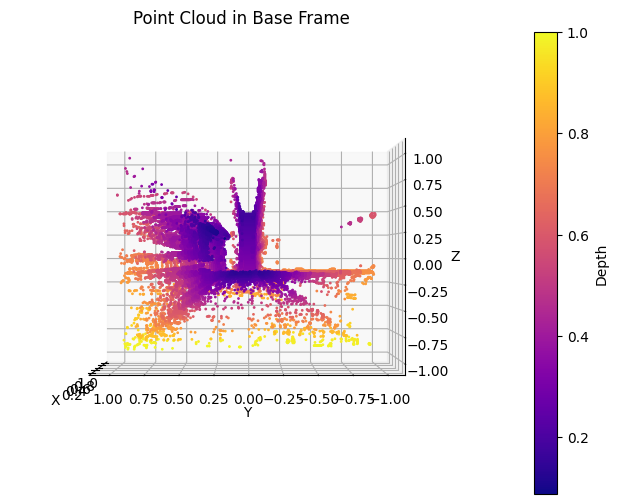

In [50]:
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(point_cloud_base[:, 0], point_cloud_base[:, 1], point_cloud_base[:, 2], c=point_cloud_base[:, 0], cmap='plasma', s=1, alpha=1.0)

cbar = plt.colorbar(sc, ax=ax, pad=0.1)
cbar.set_label("Depth")
ax.set_title("Point Cloud in Base Frame")
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
ax.view_init(elev=0, azim=180)
# plt.savefig("Assignment/base_frame.png")
plt.show()

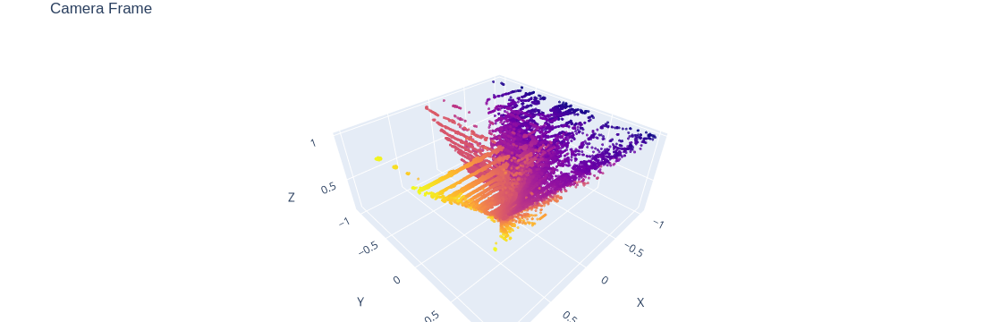

In [56]:
from plotly import graph_objects as go
fig = go.Figure(data=[go.Scatter3d(
    x=point_cloud_scaled[:, 0],
    y=point_cloud_scaled[:, 1],
    z=point_cloud_scaled[:, 2],
    mode="markers",
    marker=dict(size=1, color=point_cloud_scaled[:, 0], colorscale="plasma", opacity=0.8)
)])

fig.update_layout(
    title="Camera Frame",
    scene = dict(
        xaxis = dict(title="X"),
        yaxis = dict(title="Y"),
        zaxis= dict(title="Z")
    ),
    margin=dict(l=0, r=0, b=0, t=30)
)

fig.show()
